# Interpolation temporelle et trous chronologiques


## Exemple introductif

In [1]:
# https://pandas.pydata.org/docs/user_guide/missing_data.html#interpolation

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

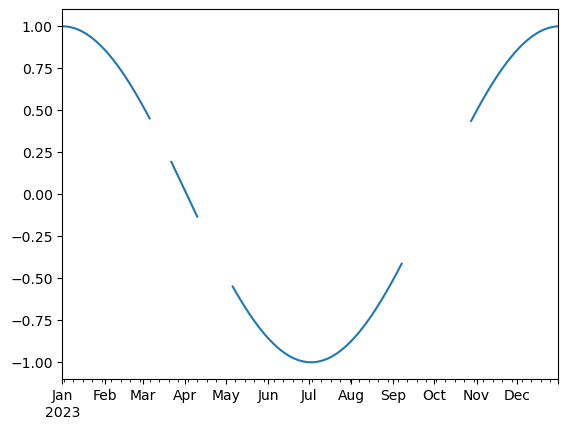

In [3]:
date = pd.date_range("01/01/2023", periods = 365, freq = 'D')
x = np.arange(0, 365)
y =  pd.Series(np.cos(2*np.pi*x/365), index=date)
y[65:80] = np.nan
y[100:125] = np.nan
y[250:300] = np.nan
y.plot()
plt.show()

In [4]:
y.count()

275

In [5]:
ybis = y.interpolate()
ybis.count()

365

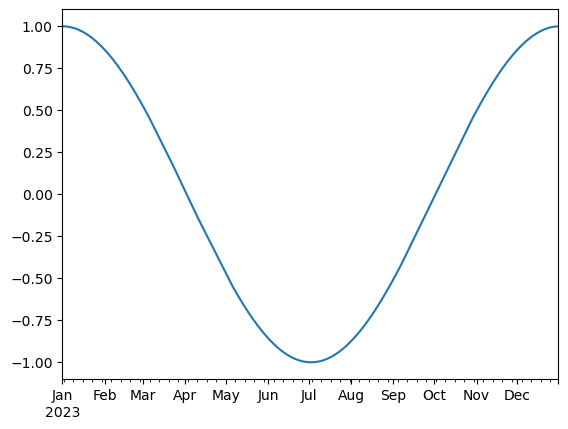

In [6]:
ybis.plot()
plt.show()

## Exemple réel sur Albury

In [7]:
df = pd.read_csv(';;/data/raw/weatherAUS.csv')
df['Date'] = pd.to_datetime(df['Date'])

df["year"] = df['Date'].dt.year
df["month"] = df['Date'].dt.month
df["day"] = df['Date'].dt.day

albury = df.loc[df['Location'] == 'Albury'].drop(columns = ['Evaporation', 'Sunshine']).copy()
albury.head(2)

,Date,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,year,month,day
0,2008-12-01,Albury,13.4,22.9,0.6,W,44.0,W,WNW,20.0,...,1007.1,8.0,NaN,16.9,21.8,No,No,2008,12,1
1,2008-12-02,Albury,7.4,25.1,0.0,WNW,44.0,NNW,WSW,4.0,...,1007.8,NaN,NaN,17.2,24.3,No,No,2008,12,2


In [8]:
round(albury.isna().sum()/albury.shape[0] *100, 1)

Date              0.0
Location          0.0
MinTemp           0.4
MaxTemp           0.4
Rainfall          1.0
WindGustDir       1.1
WindGustSpeed     1.1
WindDir9am       17.3
WindDir3pm        1.5
WindSpeed9am      0.3
WindSpeed3pm      0.4
Humidity9am       0.3
Humidity3pm       0.3
Pressure9am       0.2
Pressure3pm       0.3
Cloud9am         57.6
Cloud3pm         53.1
Temp9am           0.3
Temp3pm           0.3
RainToday         1.0
RainTomorrow      1.0
year              0.0
month             0.0
day               0.0
dtype: float64

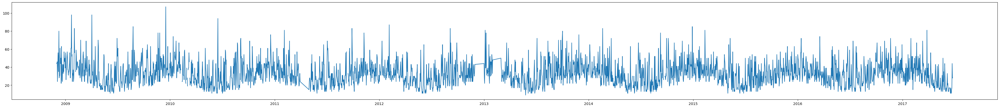

In [9]:
# On choisit de représenter 'WindGustSpeed' en fonction du temps, car c'est une valeur numérique qui contient 1.1 % de nan.
plt.figure(figsize = (50, 5))
plt.plot(albury['Date'], albury['WindGustSpeed'])
plt.show()


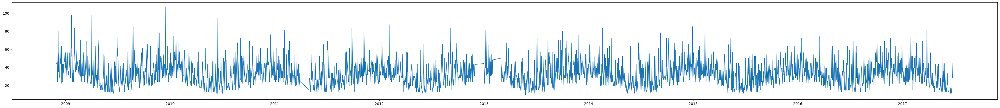

In [10]:
# On tente l'interpolation:
albury['WindGustSpeed'] = albury['WindGustSpeed'].interpolate()

plt.figure(figsize = (50, 5))
plt.plot(albury['Date'], albury['WindGustSpeed'])
plt.show()


In [11]:
round(albury.isna().sum()/albury.shape[0] *100, 1)

Date              0.0
Location          0.0
MinTemp           0.4
MaxTemp           0.4
Rainfall          1.0
WindGustDir       1.1
WindGustSpeed     0.0
WindDir9am       17.3
WindDir3pm        1.5
WindSpeed9am      0.3
WindSpeed3pm      0.4
Humidity9am       0.3
Humidity3pm       0.3
Pressure9am       0.2
Pressure3pm       0.3
Cloud9am         57.6
Cloud3pm         53.1
Temp9am           0.3
Temp3pm           0.3
RainToday         1.0
RainTomorrow      1.0
year              0.0
month             0.0
day               0.0
dtype: float64

In [12]:
# Le taux de nan de 'WindGustSpeed' est maintenant à zéro. C'était l'objectif.

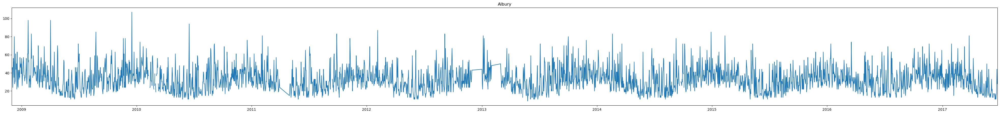

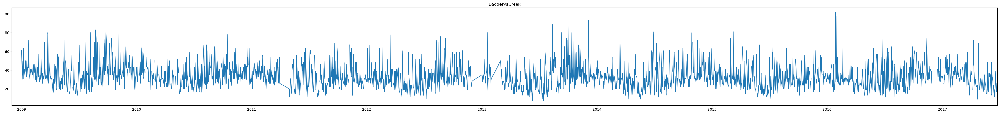

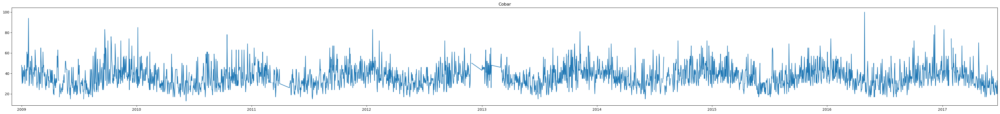

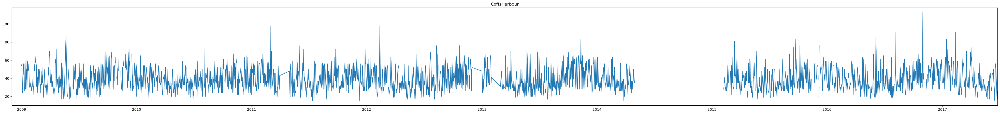

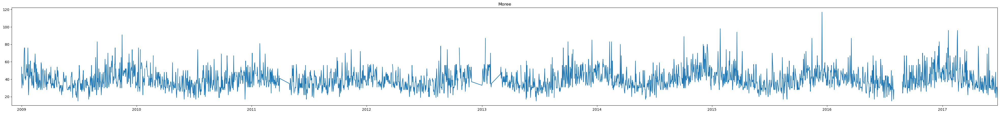

...

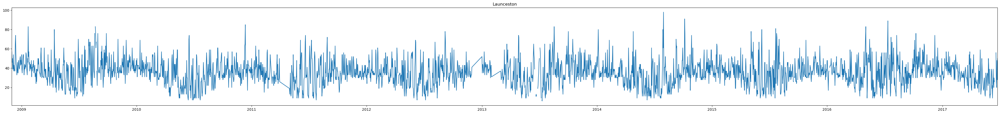

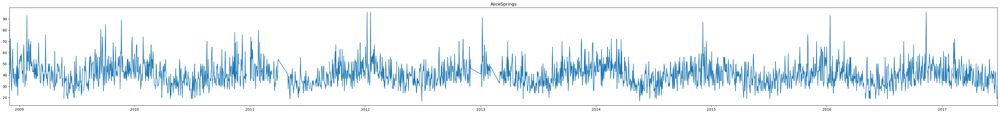

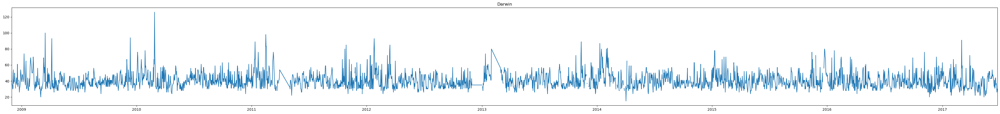

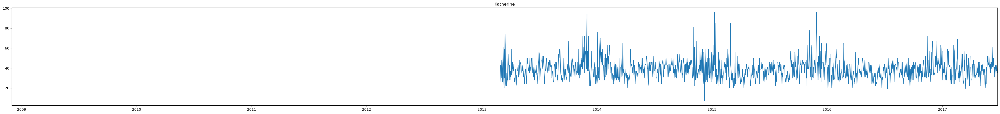

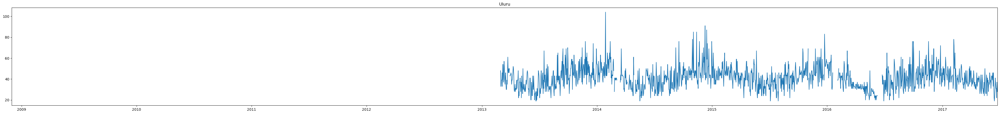

In [39]:
# Profitons-en pour rechercher les trous chronologiques et voir s'ils ont lieu en même temps pour toutes les stations.
for station in df['Location'].unique():
    plt.figure(figsize = (50, 5))
    plt.plot(df.loc[df['Location'] == station]['Date'], df.loc[df['Location'] == station]['WindGustSpeed'])
    plt.title(station)
    xmin = df.loc[df['Location'] == 'Albury']['Date'].min()
    xmax = df.loc[df['Location'] == 'Albury']['Date'].max()
    plt.xlim([xmin, xmax])
    plt.show()

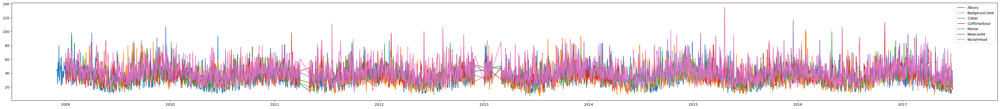

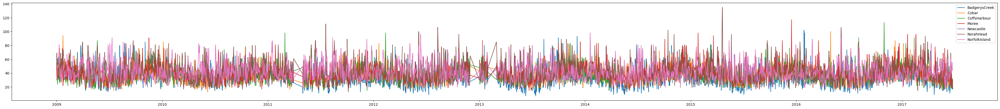

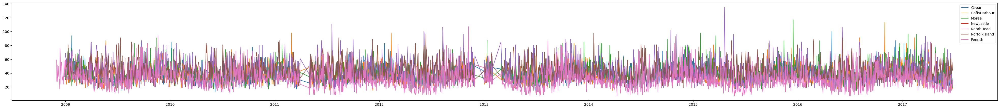

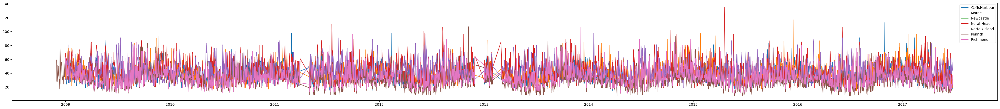

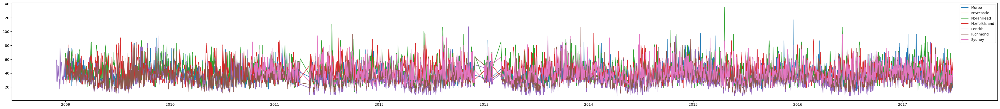

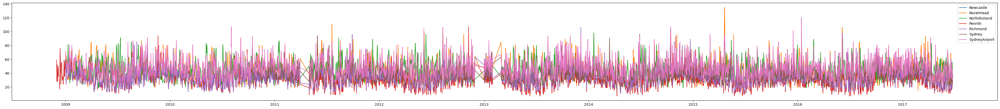

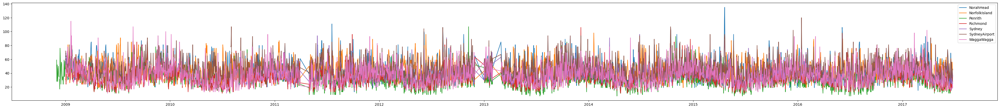

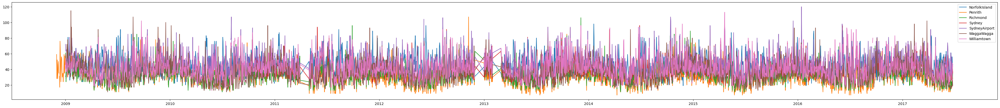

In [42]:
# Ca a bien l'air d'être le cas. Superposons 7 stations par graphique dans 7 graphiques différents pour s'en assurer:
for i in range(8): 
    plt.figure(figsize = (50, 5))
    for station in df['Location'].unique()[i:(i+7)]:
        plt.plot(df.loc[df['Location'] == station]['Date'], df.loc[df['Location'] == station]['WindGustSpeed'], label = station)
    plt.legend()
    plt.show()

 C'est bien le cas. On note trois périodes différentes d'interruption:  
    1. en 2011  
    2. fin 2012  
    3. début 2013  

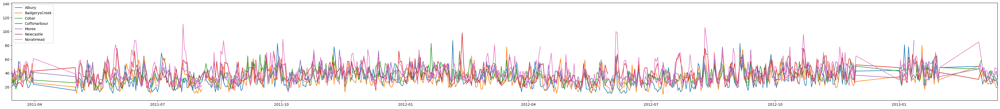

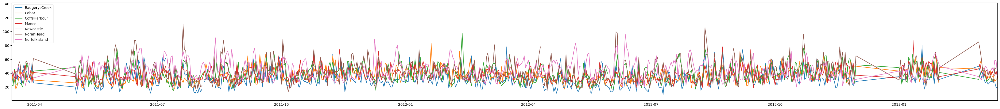

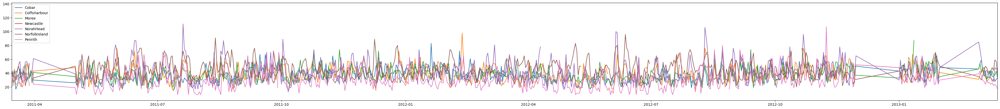

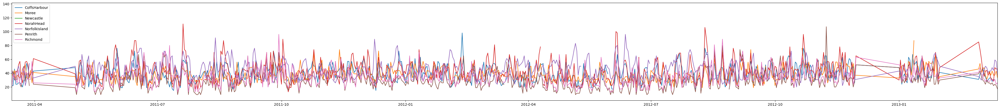

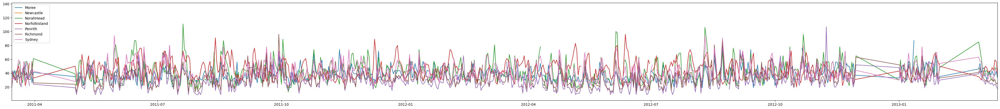

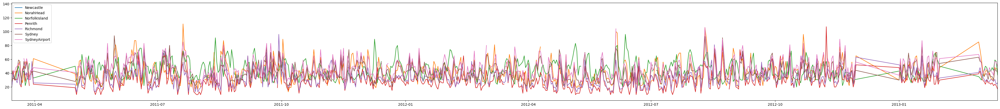

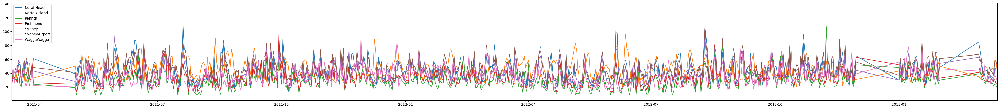

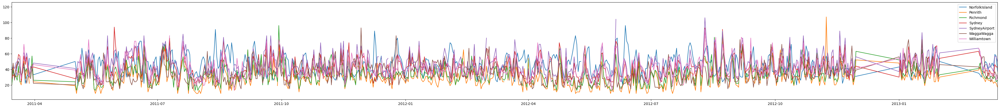

In [47]:
# Zoomons un peu:
import datetime

for i in range(8): 
    plt.figure(figsize = (50, 5))
    for station in df['Location'].unique()[i:(i+7)]:
        plt.plot(df.loc[df['Location'] == station]['Date'], df.loc[df['Location'] == station]['WindGustSpeed'], label = station)
    plt.legend()
    xmin = datetime.datetime(2011, 3, 15)
    xmax = datetime.datetime(2013, 3, 15)
    plt.xlim([xmin, xmax])
    plt.show()

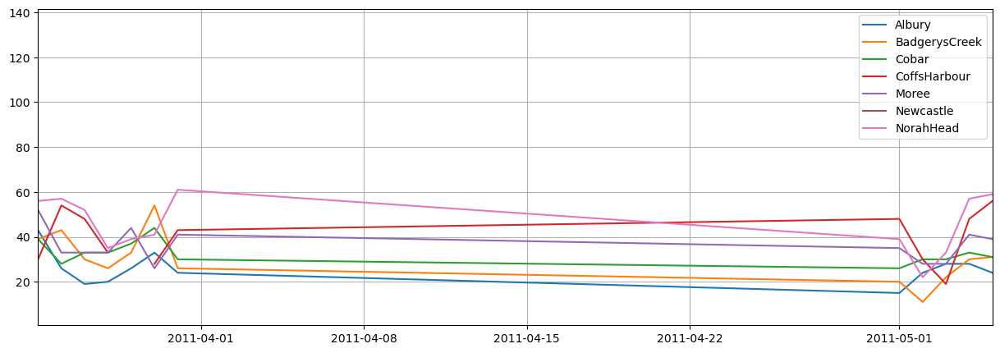

In [73]:
# (je ne fait qu'un seul graphique avec les 7 premières stations pour alléger la lecture)
# Première période : du 1er avril 2011 au 30 avril 2011.
# C'est tout le mois d'avril 2011 qui est concerné.

plt.figure(figsize = (15, 5))
for station in df['Location'].unique()[0:7]:
    plt.plot(df.loc[df['Location'] == station]['Date'], df.loc[df['Location'] == station]['WindGustSpeed'], label = station)
plt.legend()
xmin = datetime.datetime(2011, 3, 25)
xmax = datetime.datetime(2011, 5, 5)
plt.xlim([xmin, xmax])
plt.grid()
plt.show()

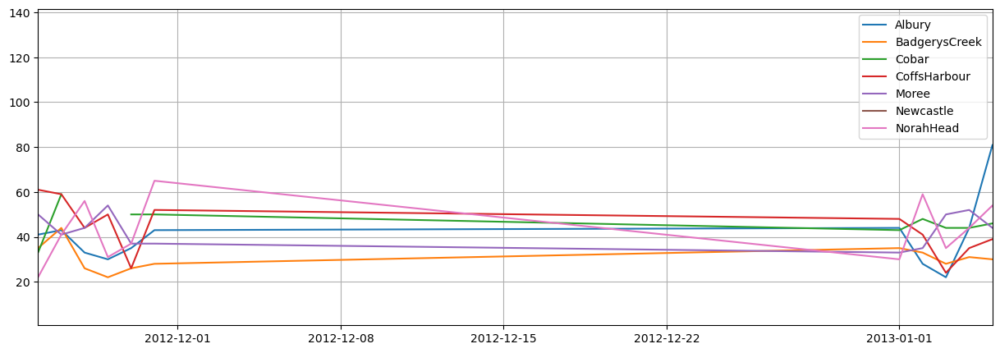

In [70]:
# Deuxième période : du 1er décembre 2012 au 31 décembre 2012
# C'est tout le mois de décembre 2012 qui est concerné.
plt.figure(figsize = (15, 5))
for station in df['Location'].unique()[0:7]:
    plt.plot(df.loc[df['Location'] == station]['Date'], df.loc[df['Location'] == station]['WindGustSpeed'], label = station)
plt.legend()
xmin = datetime.datetime(2012, 11, 25)
xmax = datetime.datetime(2013, 1, 5)
plt.xlim([xmin, xmax])
plt.grid()
plt.show()

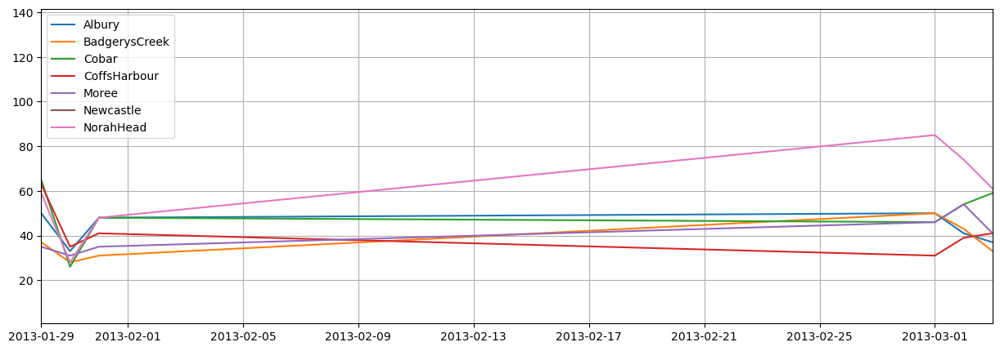

In [71]:
# Troisème période : du 1er février 2013 au 28 février 2013.
# C'est tout le mois de février 2013 qui est concerné.
 
plt.figure(figsize = (15, 5))
for station in df['Location'].unique()[0:7]:
    plt.plot(df.loc[df['Location'] == station]['Date'], df.loc[df['Location'] == station]['WindGustSpeed'], label = station)
plt.legend()
xmin = datetime.datetime(2013, 1, 29)
xmax = datetime.datetime(2013, 3, 3)
plt.xlim([xmin, xmax])
plt.grid()
plt.show()